# ANÁLISIS DE LOS PRINCIPALES GIROS COMERCIALES Y NEGOCIOS DE LOS DATASETS *metadata-sitios* y *reviews-estados*

In [2]:
# Dependencias
import os
import pandas as pd
import ast
#import plotly.express as px
from IPython.display import display
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [3]:
import folium
from folium.plugins import HeatMap
import imageio
import os
import geopandas as gpd
import contextily as ctx

# Índice

1. [ANÁLISIS DE GOOGLE MAPS (sitios)]("1-Analisis-Google")

a. [Enlista archivos disponibles en la carpeta Datasets/Parquet](#sección-1-Enlista-archivos)

b. [Carga y explora tipos de datos del archivo "combined_metadata_sitios.parquet"](#sección-2-Carga-explora)

c. [Contabiliza valores nulos en todas las columnas del dataset](#sección-3-Nulos)

d. [Explora los campos "category" y "name" para conocer los giros y negocios más y menos frecuentes](#sección-4-Frecuencias-category-name)

e. [Calcula outliers para categorías](#sección-5-outliers-categorias)

f. [Identifica el top 10 de negocios por cada una de las 10 categorías que se indentificaron como outliers por su frecuencia](#sección-6-top10-negocios-categorias)

g. [Mapa de densidad de negocios](#sección-7-densidad_negocios)


2. [ANALISIS DE NEGOCIOS DE YELP]("2-Analisis-Yelp"")

a. [Carga y explora tipos de datos del archivo "combined_metadata_sitios.parquet"](#sección-2-Carga-explora-yelp)

b. [Contabiliza valores nulos en todas las columnas del dataset](#sección-3-Nulos-yelp)

c. [Explora los campos "category" y "name" para conocer los giros y negocios más y menos frecuentes](#sección-4-Frecuencias-category-name-yelp)

d. [Calcula outliers para categorías](#sección-5-outliers-categorias-yelp)

e. [Identifica el top 10 de negocios por cada una de las 10 categorías que se indentificaron como outliers por su frecuencia](#sección-6-top10-negocios-categorias-yelp)

f. [Mapa de densidad de negocios](#sección-7-densidad_negocios-yelp)


# 1. ANÁLISIS DE GOOGLE MAPS (sitios)
<a id="1-Analisis-Google"></a>

## a. Enlista archivos disponibles en la carpeta Datasets/Parquet
<a id="sección-1-Enlista-archivos"></a>

In [5]:
# Ruta a la carpeta específica: hice un shortcut de la carpeta compartida (Compartidos conmigo/Google Maps) y lo puse en mi carpeta en My Drive

# Cada quien tiene que hacer su shortcut y cambiar este path
path_parquets = r'G:\My Drive\HENRY\PROYECTO_FINAL\DATASETS\PARQUET'

# Listar archivos en la carpeta
files = os.listdir(path_parquets)
for file in files:
    print(file)


yelp_review.parquet
yelp_business.parquet
user.parquet
combined_reviews_california.parquet
combined_metadata_sitios.parquet
checkin.parquet
yelp_tip.parquet


## b. Carga y explora tipos de datos del archivo "combined_metadata_sitios.parquet"
<a id="sección-2-Carga-explora"></a>

In [6]:
# Ruta al archivo
file_path = os.path.join(path_parquets, 'combined_metadata_sitios.parquet')

metadata_sitios = pd.read_parquet(file_path, engine='pyarrow')

In [6]:
metadata_sitios.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3025011 entries, 0 to 3025010
Data columns (total 15 columns):
 #   Column            Dtype  
---  ------            -----  
 0   name              string 
 1   address           string 
 2   gmap_id           string 
 3   description       string 
 4   latitude          float64
 5   longitude         float64
 6   category          string 
 7   avg_rating        float64
 8   num_of_reviews    int64  
 9   price             string 
 10  hours             string 
 11  MISC              string 
 12  state             string 
 13  relative_results  string 
 14  url               string 
dtypes: float64(3), int64(1), string(11)
memory usage: 346.2 MB


In [7]:
print(metadata_sitios.head())

               name                                            address  \
0   Porter Pharmacy  Porter Pharmacy, 129 N Second St, Cochran, GA ...   
1      City Textile  City Textile, 3001 E Pico Blvd, Los Angeles, C...   
2      San Soo Dang  San Soo Dang, 761 S Vermont Ave, Los Angeles, ...   
3      Nova Fabrics  Nova Fabrics, 2200 E 11th St, Los Angeles, CA ...   
4  Nobel Textile Co  Nobel Textile Co, 719 E 9th St, Los Angeles, C...   

                                 gmap_id description   latitude   longitude  \
0  0x88f16e41928ff687:0x883dad4fd048e8f8        <NA>  32.388300  -83.357100   
1  0x80c2c98c0e3c16fd:0x29ec8a728764fdf9        <NA>  34.018891 -118.215290   
2  0x80c2c778e3b73d33:0xbdc58662a4a97d49        <NA>  34.058092 -118.292130   
3   0x80c2c89923b27a41:0x32041559418d447        <NA>  34.023669 -118.232930   
4  0x80c2c632f933b073:0xc31785961fe826a6        <NA>  34.036694 -118.249421   

                category  avg_rating  num_of_reviews price  \
0           ['Phar

## c. Contabiliza valores nulos en todas las columnas del dataset
<a id="sección-3-Nulos"></a>

In [5]:
# Leer el archivo Parquet utilizando pyarrow
df_pyarrow = pd.read_parquet(file_path, engine='pyarrow')
print("Datos leídos con pyarrow:")
#print(df_pyarrow.head())
#print(df_pyarrow.info())
print(df_pyarrow.isnull().sum())
# Leer el archivo Parquet utilizando fastparquet
df_fastparquet = pd.read_parquet(file_path, engine='fastparquet')
print("Datos leídos con fastparquet:")
#print(df_fastparquet.head())
#print(df_fastparquet.info())
print(df_fastparquet.isnull().sum())

Datos leídos con pyarrow:
name                     37
address               80511
gmap_id                   0
description         2770722
latitude                  0
longitude                 0
category              17419
avg_rating                0
num_of_reviews            0
price               2749808
hours                787405
MISC                 690834
state                746455
relative_results     295058
url                       0
dtype: int64
Datos leídos con fastparquet:
name                     37
address               80511
gmap_id                   0
description         2770722
latitude                  0
longitude                 0
category              17419
avg_rating                0
num_of_reviews            0
price               2749808
hours                787405
MISC                 690834
state                746455
relative_results     295058
url                       0
dtype: int64


In [5]:
# Buscar valores nulos en todas las columnas de metadata_sitios y calcular porcentaje de nulos
nulos = metadata_sitios.isnull().sum()
porcentaje = (metadata_sitios.isnull().sum() / len(metadata_sitios)) * 100

# Crear un DataFrame con los resultados
reporte_nulos = pd.DataFrame({'Valores Nulos': nulos, 'Porcentaje': porcentaje})

# Mostrar los resultados
display(reporte_nulos)

,Valores Nulos,Porcentaje
name,37,0.001223
address,80511,2.661511
gmap_id,0,0.000000
description,2770722,91.593783
latitude,0,0.000000
longitude,0,0.000000
category,17419,0.575833
avg_rating,0,0.000000
num_of_reviews,0,0.000000
price,2749808,90.902413


In [6]:
'''Se detectó que cuando el archivo "combined_metadata_sitios.parquet se lee sin en motor pyarrow hay diferencias en cuanto a los valores nulos del campo "category". Se atribuye al hecho de que este campo contiene listas que al inicio se definen como cadenas de texto STRING. Esto puede generar que una lectura sin un motor como pyarrow no interpete correctamente la información.'''
metadata_sitios2 = pd.read_parquet(file_path)
# Buscar valores nulos en todas las columnas de metadata_sitios y calcular porcentaje de nulos
nulos2 = metadata_sitios2.isnull().sum()
porcentaje2 = (metadata_sitios2.isnull().sum() / len(metadata_sitios2)) * 100

# Crear un DataFrame con los resultados
reporte_nulos2 = pd.DataFrame({'Valores Nulos': nulos2, 'Porcentaje': porcentaje2})

# Mostrar los resultados
display(reporte_nulos2)

,Valores Nulos,Porcentaje
name,37,0.001223
address,80511,2.661511
gmap_id,0,0.000000
description,2770722,91.593783
latitude,0,0.000000
longitude,0,0.000000
category,17419,0.575833
avg_rating,0,0.000000
num_of_reviews,0,0.000000
price,2749808,90.902413


## d. Explora las columnas "category" y "name" para conocer los giros y negocios más y menos frecuentes
<a id="sección-4-Frecuencias-category-name"></a>

In [7]:
''' Se observa que el campo "category" contiene listas y en algunos casos, listas de listas; sin embargo, el tipo de dato en este campo está definido como STRING, por lo que antes de explotarlo hay que convertilo a listas'''
# Función para asegurar que todos los elementos sean listas
def ensure_list(x):
    if isinstance(x, str):
        # Intenta convertir una cadena que parece una lista en una lista real
        try:
            return ast.literal_eval(x)
        except (ValueError, SyntaxError):
            return [x]
    elif not isinstance(x, list):
        return [x]
    return x

# Aplicar la función para asegurar que todos los elementos son listas
metadata_sitios['category'] = metadata_sitios['category'].apply(ensure_list)

# Verificar nuevamente los tipos después de la conversión
print(metadata_sitios['category'].apply(type).unique())

# Función para explotar completamente una columna específica
def fully_explode_column(df, column):
    while df[column].apply(lambda x: isinstance(x, list)).any():
        df = df.explode(column)
    return df

# Aplicar la función a la columna 'category'
df_exploded = fully_explode_column(metadata_sitios, 'category')

# Mostrar el DataFrame con la columna 'category' completamente explotada
print(df_exploded)


[<class 'list'>]
                                   name  \
0                       Porter Pharmacy   
1                          City Textile   
2                          San Soo Dang   
3                          Nova Fabrics   
4                      Nobel Textile Co   
...                                 ...   
3025006                        Steak 48   
3025007   Jack Mcnerney Chevrolet, Inc.   
3025008  Central Ny Spay Neuter Assista   
3025009                   Ok Feed Store   
3025010              Crestview Crossing   

                                                   address  \
0        Porter Pharmacy, 129 N Second St, Cochran, GA ...   
1        City Textile, 3001 E Pico Blvd, Los Angeles, C...   
2        San Soo Dang, 761 S Vermont Ave, Los Angeles, ...   
3        Nova Fabrics, 2200 E 11th St, Los Angeles, CA ...   
4        Nobel Textile Co, 719 E 9th St, Los Angeles, C...   
...                                                    ...   
3025006   Steak 48, 260 S Broad 

In [11]:
print(df_exploded.isnull().sum())

name                     37
address              228002
gmap_id                   0
description         5352160
latitude                  0
longitude                 0
category              17419
avg_rating                0
num_of_reviews            0
price               5339180
hours               1033086
MISC                1134688
state                977882
relative_results     471039
url                       0
dtype: int64


In [8]:
'''Cuenta valores únicos en category y name'''
# Encuentra los valores únicos en "category" y cuenta las ocurrencias
unicos_category = df_exploded['category'].value_counts()

# Encuentra los valores únicos en "name" y cuenta las ocurrencias
unicos_name = df_exploded['name'].value_counts()


In [13]:
# Mostrar las categorías más y menos frecuentes en el campo "category"
print("Categorías más frecuentes:")
print(unicos_category.head())

print("\nCategorías menos frecuentes:")
print(unicos_category.tail())

Categorías más frecuentes:
category
Restaurant               97257
Auto repair shop         77854
Gas station              70143
Service establishment    66476
Beauty salon             65717
Name: count, dtype: int64

Categorías menos frecuentes:
category
Mobile phone            1
Child center            1
Pediatric urologist     1
Marquee hire service    1
Waste container         1
Name: count, dtype: int64


In [14]:
# Mostrar las categorías más y menos frecuentes en el campo "name"
print("Categorías más frecuentes:")
print(unicos_name.head())

print("\nCategorías menos frecuentes:")
print(unicos_name.tail())

Categorías más frecuentes:
name
Subway                          43747
Walgreens                       32112
Family Dollar                   31829
United States Postal Service    31253
The UPS Store                   25755
Name: count, dtype: Int64

Categorías menos frecuentes:
name
Geneva Cleaners                     1
Broward Electric Car & Equipment    1
CTS Engines                         1
JacoSpa                             1
Crestview Crossing                  1
Name: count, dtype: Int64


In [10]:
'''Se guarda el conteo de valores únicos de "category" y "name" para futuros análisis'''
# Guardar el DataFrame como un archivo CSV
unicos_category.to_csv('/content/drive/MyDrive/HENRY/PROYECTO_FINAL/DATASETS/CSV/unicos_category.csv', index=False)

unicos_name.to_csv('/content/drive/MyDrive/HENRY/PROYECTO_FINAL/DATASETS/CSV/unicos_name.csv', index=False)

## e.  Calcula outliers para categorías
<a id="sección-5-outliers-categorias"></a>

In [9]:
# Calcular los cuartiles y el rango intercuartílico
Q1 = unicos_category.quantile(0.25)
Q3 = unicos_category.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son outliers
outliers = unicos_category[(unicos_category < limite_inferior) | (unicos_category > limite_superior)]
print("\nOutliers top 10 (arriba del límite superior):")
print(outliers.head(10))

print("\nOutliers top 10 (debajo del límite inferior):")
print(outliers.tail(10))


Outliers top 10 (arriba del límite superior):
category
Restaurant               97257
Auto repair shop         77854
Gas station              70143
Service establishment    66476
Beauty salon             65717
Convenience store        62165
Church                   53069
Hair salon               51765
Nail salon               44597
ATM                      42452
Name: count, dtype: int64

Outliers top 10 (debajo del límite inferior):
category
Flower delivery       2183
Paint manufacturer    2183
Wedding planner       2182
Tuxedo shop           2178
Medical office        2178
Cabinet maker         2177
Uniform store         2169
Fuel pump             2163
Laboratory            2161
Middle school         2159
Name: count, dtype: int64


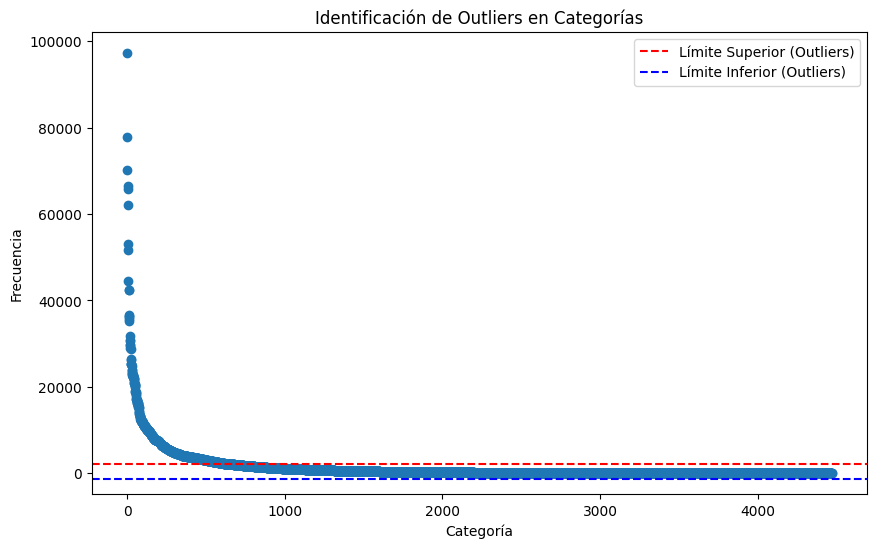

In [16]:
# Gráfico de puntos para identificar outliers
plt.figure(figsize=(10, 6))
plt.scatter(range(len(unicos_category)), unicos_category)
plt.axhline(y=limite_superior, color='r', linestyle='--', label='Límite Superior (Outliers)')
plt.axhline(y=limite_inferior, color='b', linestyle='--', label='Límite Inferior (Outliers)')
plt.title('Identificación de Outliers en Categorías')
plt.xlabel('Categoría')
plt.ylabel('Frecuencia')
plt.legend()
plt.show()


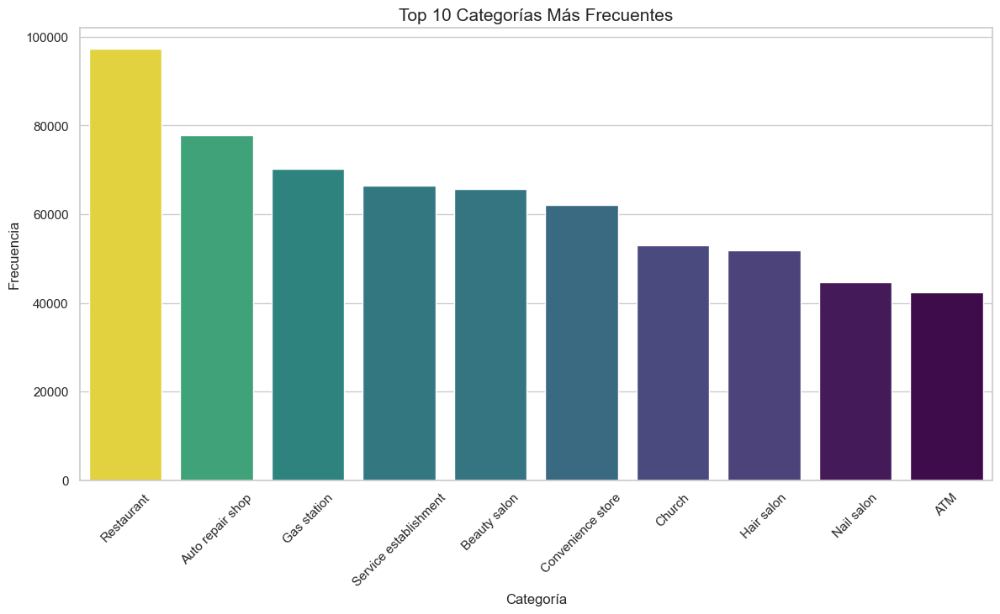

In [17]:
# Configuración de estilo
sns.set(style="whitegrid")

# Gráfico de barras para las categorías más frecuentes
plt.figure(figsize=(14, 7))
sns.barplot(x=unicos_category.head(10).index, y=unicos_category.head(10).values, palette="viridis", hue=unicos_category.head(10), dodge=False, legend=False)
plt.title('Top 10 Categorías Más Frecuentes', fontsize=15)
plt.xlabel('Categoría', fontsize=12)
plt.ylabel('Frecuencia', fontsize=12)
plt.xticks(rotation=45)
plt.show()

In [10]:
# Calcular la frecuencia de cada categoría
frecuencia_categorias = df_exploded['category'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = frecuencia_categorias.quantile(0.25)
Q3 = frecuencia_categorias.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son outliers (por arriba del límite superior)
outliers_sup = frecuencia_categorias[frecuencia_categorias > limite_superior]
top_10_outliers = outliers_sup.head(10)
categorias_outliers = top_10_outliers.index

# Obtener los nombres de las empresas y contar el número de empresas por categoría outlier
nombres_categorias_outliers = df_exploded[df_exploded['category'].isin(categorias_outliers)].groupby(['category'])['name'].apply(lambda x: ', '.join(x.unique())).reset_index()
numero_empresas_por_categoria = df_exploded[df_exploded['category'].isin(categorias_outliers)].groupby(['category'])['name'].nunique().reset_index(name='number_of_companies')

# Crear un DataFrame final con la información requerida
df_resultado = pd.DataFrame({
    'category': top_10_outliers.index,
    'frequency': top_10_outliers.values,
}).merge(nombres_categorias_outliers, on='category').merge(numero_empresas_por_categoria, on='category')

# Renombrar las columnas para los encabezados especificados
df_resultado.columns = ['Categoría', 'Frecuencia Categoría', 'Nombre de los negocios', 'Número de negocios']

display(df_resultado)


,Categoría,Frecuencia Categoría,Nombre de los negocios,Número de negocios
0,Restaurant,97257,"Vons Chicken, Vivi Bubble Tea, Hale Pops, Cape...",70062
1,Auto repair shop,77854,"Knight Hawk, Jeff's Auto Repair, Timmons Auto ...",65042
2,Gas station,70143,"Harvest Land Co-op, Maverik Adventure's First ...",21800
3,Service establishment,66476,"PeepNotes, Lawn Care Solutions, iPolish Nails ...",63790
4,Beauty salon,65717,"Lena’s Beauty Nails Lashes Brows, The Beauty B...",50526
5,Convenience store,62165,"Timewise Food Store, Maverik Adventure's First...",15551
6,Church,53069,"Burnette Baptist Church, Origin Church, Life P...",36383
7,Hair salon,51765,"Excel Hair & Nails, Ely's Beauty Salon, Cuttin...",40291
8,Nail salon,44597,"Polished Nail Salon & Spa, Excel Hair & Nails,...",29913
9,ATM,42452,"University Federal Credit Union, Granite Credi...",8522


In [10]:
# Guardar el DataFrame como un archivo Parquet
df_resultado.to_parquet('Top10Categorias_negocios.parquet', engine='pyarrow', index=False)

## f. Identifica top 10 de negocios por cada una de las 10 categorías que se identifican como outliers por su frecuencia
<a id="sección-6-top10-negocios-categorias"></a>

In [11]:
# Calcular el top 10 de negocios para cada categoría
resultados_finales = []
for categoria in categorias_outliers:
    df_categoria = df_exploded[df_exploded['category'] == categoria]
    top_10_negocios = df_categoria['name'].value_counts().head(10)
    total_negocios_categoria = df_categoria['name'].value_counts().sum()
    for negocio, frecuencia in top_10_negocios.items():
        porcentaje = (frecuencia / total_negocios_categoria) * 100
        resultados_finales.append([categoria, negocio, frecuencia, porcentaje])

# Crear un DataFrame final con el top 10 de negocios para cada categoría, su frecuencia y porcentaje
df_top_negocios = pd.DataFrame(resultados_finales, columns=['Categoría', 'Negocio', 'Frecuencia', 'Porcentaje'])

# Mostrar el DataFrame final
display(df_top_negocios)

,Categoría,Negocio,Frecuencia,Porcentaje
0,Restaurant,Subway,8695,8.940231
1,Restaurant,Shell,1585,1.629703
2,Restaurant,McDonald's,969,0.996329
3,Restaurant,bp,618,0.635430
4,Restaurant,Taco Bell,570,0.586076
...,...,...,...,...
95,ATM,PNC Bank,812,1.912749
96,ATM,ATM,660,1.554697
97,ATM,TD Bank,572,1.347404
98,ATM,Wells Fargo ATM,490,1.154245


In [12]:
# Guardar el DataFrame como un archivo csv
df_resultado.to_csv('Top10Categorias_Top10negocios.csv', index=False)

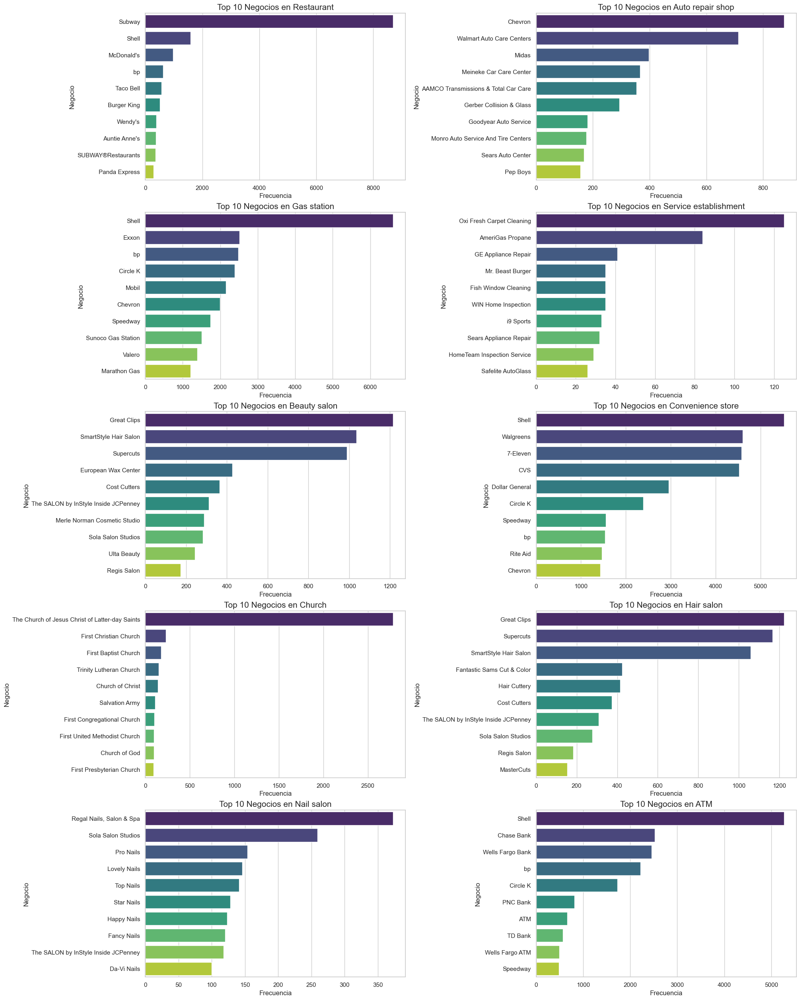

In [20]:
# Crear gráficos para cada categoría
sns.set(style="whitegrid")
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 25), constrained_layout=True)

for i, categoria in enumerate(categorias_outliers):
    df_categoria = df_top_negocios[df_top_negocios['Categoría'] == categoria]
    ax = axes[i // 2, i % 2]
    sns.barplot(x='Frecuencia', y='Negocio', hue='Negocio', data=df_categoria, ax=ax, palette="viridis", dodge=False, legend=False)
    ax.set_title(f'Top 10 Negocios en {categoria}', fontsize=15)
    ax.set_xlabel('Frecuencia', fontsize=12)
    ax.set_ylabel('Negocio', fontsize=12)

plt.show()

## g. Mapa de densidad de negocios
<a id="sección-7-densidad_negocios"></a>

In [12]:
# Filtrar los datos según el DataFrame resultados_finales
top_categories = df_top_negocios['Categoría'].tolist()
df_filtered = df_exploded[df_exploded['category'].isin(top_categories)]

# Crear un mapa base con folium
m = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# Agregar datos de densidad al mapa
heat_data = [[row['latitude'], row['longitude']] for index, row in df_filtered.iterrows()]
HeatMap(heat_data).add_to(m)

m


## h. Análisis de negocios (sin cadenas grandes)
<a id="sección-8-negocios"></a>

In [ ]:
## Lista de dataframes que se usan para este analisis:
metadata_sitios # Dataframe original, completo y sin explotar por categorias de negocios (rubros)
df_exploded # Datframe metadata_sitios EXPLOTADO completo
df_filtered # Dataframe metadata_sitios EXPLOTADO segmentado para los negocios cuyas categorias se consideran outliers debido a que su 
            # frecuencia está por arriba del límite superior, es decir las categorías más frecuentes
df_top_negocios # Dataframe de los 10 negocios más frecuentes para cada una de las 10 categorías outliers
unicos_category # Frecuencia de cada categoría dentro del dataframe original
unicos_name # Frecuencia de cada negocio dentro del dataframe original


In [13]:
''' Primero segmenta el dataframe original explotado para obtener solo la información de negocios cuya categoría sea "Restaurant" '''
restaurants = df_exploded[df_exploded['category'] == 'Restaurant']
print('Hay ',len(restaurants), 'negocios en la categoría "Restaurant"')

Hay  97257 negocios en la categoría "Restaurant"


In [65]:
'''Calcula outliers para negocios en el df original (metadata_sitios) para identificar los negocios más frecuentes y que muy probablemente
pudieran pertenecer a una cadena grande. Sin embargo se detecta un problema con el cálculo de rango intercuartil
 pues es igual a O. Puede indicar que los datos se acumulan alrededor de un valor específico'''
# Calcular la frecuencia de cada restaurante
frecuencia_restaurants = restaurants['name'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = frecuencia_restaurants.quantile(0.25)
Q3 = frecuencia_restaurants.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son outliers
outliers_restaurants = frecuencia_restaurants[(frecuencia_restaurants < limite_inferior) | (frecuencia_restaurants > limite_superior)]
print("\nOutliers top 10 (arriba del límite superior = ", limite_superior,"):")
display(outliers_restaurants.head(10))

print("\nOutliers top 10 (debajo del límite inferior = ",limite_inferior,"):")
display(outliers_restaurants.tail(10))



Outliers top 10 (arriba del límite superior =  1.0 ):


name
Subway                8695
Shell                 1585
McDonald's             969
bp                     618
Taco Bell              570
Burger King            518
Wendy's                383
Auntie Anne's          379
SUBWAY®Restaurants     360
Panda Express          289
Name: count, dtype: Int64


Outliers top 10 (debajo del límite inferior =  1.0 ):


name
The Grub Hub       2
Cellar Bistro      2
Mama's Pizza       2
River House        2
Sake House         2
Boujie Biscuit     2
Slater's 50/50     2
The River House    2
Jia                2
Fusion Cafe        2
Name: count, dtype: Int64

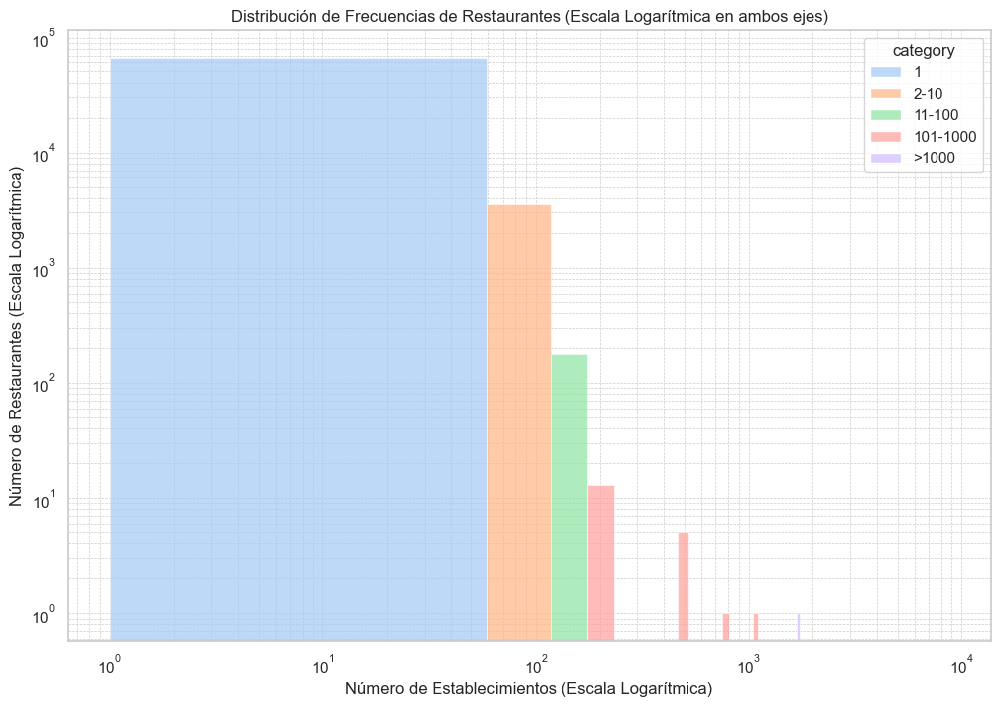

In [63]:
'''Se genera una gráfica de rangos de frecuencias para determinar el número de restaurantes que poseen
distintos números de establecimientos. Se observa que la gran mayoría solo tiene 1 establecimiento.'''

# Calcular la frecuencia de cada restaurante
frecuencia_restaurants = restaurants['name'].value_counts().reset_index()
frecuencia_restaurants.columns = ['name', 'count']

# Categorizar frecuencias en grupos
frecuencia_restaurants['category'] = pd.cut(frecuencia_restaurants['count'], 
                                             bins=[0, 1, 10, 100, 1000, frecuencia_restaurants['count'].max()], 
                                             labels=['1', '2-10', '11-100', '101-1000', '>1000'], include_lowest=True)

# Configurar el estilo de Seaborn y usar colores pastel
sns.set(style="whitegrid")
sns.set_palette("pastel")

# Crear el histograma con escala logarítmica en el eje y
plt.figure(figsize=(12, 8))
ax = sns.histplot(data=frecuencia_restaurants, x='count', hue='category', bins=30, kde=False, multiple='dodge', alpha=0.7)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_title('Distribución de Frecuencias de Restaurantes (Escala Logarítmica en ambos ejes)')
ax.set_xlabel('Número de Establecimientos (Escala Logarítmica)')
ax.set_ylabel('Número de Restaurantes (Escala Logarítmica)')

# Ajustar la cuadrícula para la escala logarítmica
ax.grid(True, which="both", ls="--", linewidth=0.5)

# Configurar la leyenda
#handles, labels = ax.get_legend_handles_labels()
#ax.legend(handles, labels, title='Categoría de Frecuencia', loc='upper right')
plt.show()


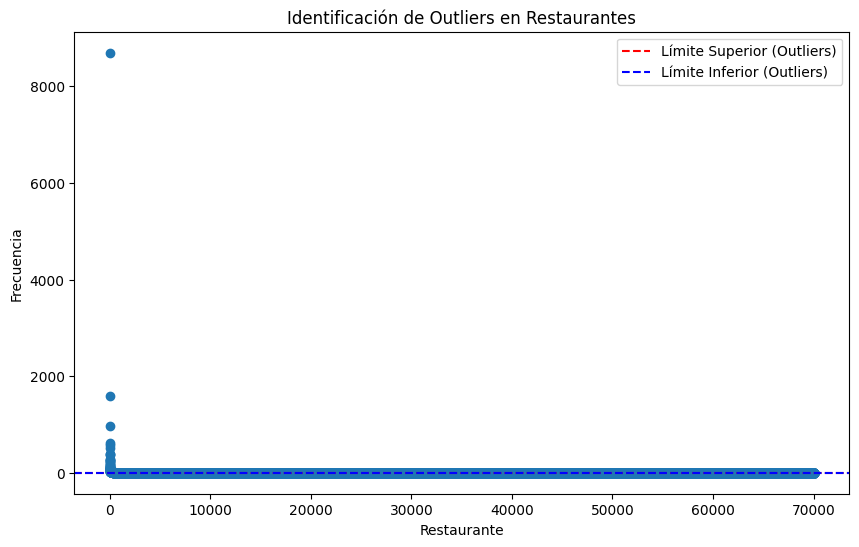

In [25]:
# Gráfico de puntos para identificar outliers
plt.figure(figsize=(10, 6))
plt.scatter(range(len(frecuencia_restaurants)), frecuencia_restaurants)
plt.axhline(y=limite_superior, color='r', linestyle='--', label='Límite Superior (Outliers)')
plt.axhline(y=limite_inferior, color='b', linestyle='--', label='Límite Inferior (Outliers)')
plt.title('Identificación de Outliers en Restaurantes')
plt.xlabel('Restaurante')
plt.ylabel('Frecuencia')
plt.legend()
plt.show()

,name,address,gmap_id,description,latitude,longitude,category,avg_rating,num_of_reviews,price,hours,MISC,state,relative_results,url
53280,Grill Master Cafe,"Grill Master Cafe, 1203 Montague Ave Ext, Gree...",0x88f801ad1bc2f8d5:0x4494991e9862d8ca,<NA>,34.213062,-82.179955,Restaurant,2.0,2,<NA>,<NA>,"{'Service options': ['Delivery'], 'Accessibili...",<NA>,<NA>,https://www.google.com/maps/place//data=!4m2!3...
53426,Eurasian Grill,"Eurasian Grill, 4771 Haggerty Rd, West Bloomfi...",0x8824a4c3afac6b5f:0x5350729d3d4bbfd2,<NA>,42.564690,-83.436679,Restaurant,3.4,8,$$$,"[['Tuesday', '4:30–10PM'], ['Wednesday', '4:30...","{'Service options': ['Delivery'], 'Popular for...",Permanently closed,"['0x8824ba12eefdb71d:0xb65170186e57006c', '0x8...",https://www.google.com/maps/place//data=!4m2!3...
53710,Cafe Gelato,"Cafe Gelato, 6000 Glades Rd # 1208B, Boca Rato...",0x88d91e7bcdb33c35:0xa506165883250012,<NA>,26.363604,-80.132074,Restaurant,4.1,7,<NA>,"[['Tuesday', '10AM–9PM'], ['Wednesday', '10AM–...","{'Service options': ['Delivery'], 'Highlights'...",Permanently closed,<NA>,https://www.google.com/maps/place//data=!4m2!3...
53768,Neveah's Cafe,"Neveah's Cafe, 1431 11th Ave, Helena, MT 59601",0x534355482b37667d:0x648ac0cb98c571c8,<NA>,46.589462,-112.015013,Restaurant,4.8,48,<NA>,"[['Tuesday', '12–7:30PM'], ['Wednesday', '12–7...",{'Amenities': ['Good for kids']},Permanently closed,"['0x4107558339eb301f:0xb35f67ab74994c98', '0x5...",https://www.google.com/maps/place//data=!4m2!3...
53831,Saigon Noodle,"Saigon Noodle, 12313 Bellaire Blvd Suite O, Ho...",0x8640dd3e9bd780f3:0xb44cd267d6989110,<NA>,29.703033,-95.596939,Restaurant,4.7,35,<NA>,"[['Tuesday', '10AM–8PM'], ['Wednesday', '10AM–...","{'Service options': ['Delivery', 'Takeout', 'D...",Closed ⋅ Opens 10AM Wed,<NA>,https://www.google.com/maps/place//data=!4m2!3...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3024918,El guero Mexican restaurant & cantina,"El guero Mexican restaurant & cantina, N1481 W...",0x880490cefb546bcd:0x34ab1130b391421,<NA>,43.593117,-87.940267,Restaurant,4.3,158,$,"[['Monday', '11AM–9PM'], ['Tuesday', '11AM–9PM...","{'Service options': ['Takeout', 'Dine-in', 'De...",Closed ⋅ Opens 11AM,"['0x88049dbb347b2b11:0xea363a7c6146a455', '0x8...",https://www.google.com/maps/place//data=!4m2!3...
3024947,Royal Bavarian Schnitzel Haus,"Royal Bavarian Schnitzel Haus, 1085 NE 79th St...",0x88d9b3cd3f274101:0x64335c60e4e3065e,Old-world Bavarian food hall with a menu of tr...,25.848295,-80.174799,Restaurant,4.3,144,$$,"[['Monday', '5–11PM'], ['Tuesday', '6–11PM'], ...","{'Service options': ['Delivery'], 'Amenities':...",Permanently closed,"['0x88d9b42010ea8cc1:0x564f1011f4820906', '0x8...",https://www.google.com/maps/place//data=!4m2!3...
3024959,L'Attitude Bistro,"L'Attitude Bistro, 1303 Hwy 65 S, Clinton, AR ...",0x87d20a853ed28db3:0xf9f5131532efe5d5,<NA>,35.576696,-92.450840,Restaurant,4.5,226,$$,"[['Monday', 'Closed'], ['Tuesday', '11AM–8PM']...","{'Service options': ['Curbside pickup', 'Takeo...",Closed ⋅ Opens 11AM Tue,"['0x87cdf5876023d1ef:0xd28288bb47cf5fda', '0x8...",https://www.google.com/maps/place//data=!4m2!3...
3024979,"Simple Simon's Pizza - Vilonia, AR","Simple Simon's Pizza - Vilonia, AR, 14 S Churc...",0x87d28d5aa640a9c5:0x3c9cc5d3a99de80c,<NA>,35.081871,-92.207739,Restaurant,4.5,38,<NA>,"[['Monday', '11AM–8PM'], ['Tuesday', '11AM–8PM...","{'Service options': ['Takeout'], 'Popular for'...",Closed ⋅ Opens 11AM,<NA>,https://www.google.com/maps/place//data=!4m2!3...


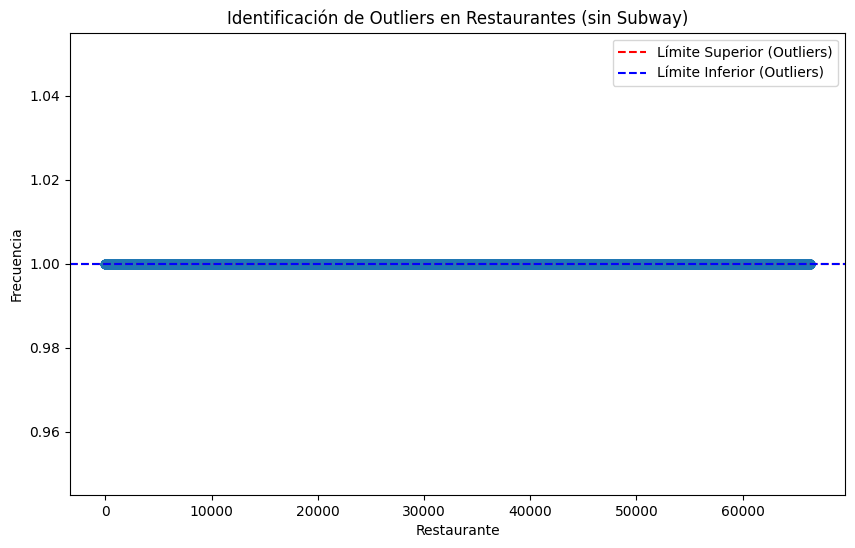

,Nombre del restaurante,Número de restaurantes,Porcentaje
0,Grill Master Cafe,1,0.0
1,Lisa's Delights Cuisine,1,0.0
2,Fatty's Main Street Grill,1,0.0
3,Amazonica,1,0.0
4,BellStores,1,0.0
5,Torta Express,1,0.0
6,Gabriella's Restaurant,1,0.0
7,Cafe Gelato,1,0.0
8,Neveah's Cafe,1,0.0
9,Saigon Noodle,1,0.0


In [29]:
'''La diferencia en frecuencia entre el top 10 y el resto es bastante grande de acuerdo al análisis de 
outliers. Ahora, se explorará la distribución de frecuencias de los restaurantes que no se consideren 
outliers, es decir restaurantes inliers. PENDIENTE: Redefinir outliers, de manera que los límites entre 
percentiles sean más adecuados para este tipo de datos en los cuales la mayoría están entorno al  mismo valor
(en este caso, 1)'''

# Calcular la frecuencia de cada restaurante
frecuencia_restaurants = restaurants['name'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = frecuencia_restaurants.quantile(0.25)
Q3 = frecuencia_restaurants.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son inliers
inliers = frecuencia_restaurants[(frecuencia_restaurants >= limite_inferior) & (frecuencia_restaurants <= limite_superior)]
# display(inliers)

# Se define un nuevo df para analizar solo los restaurantes que no se consideran cadenas ni son demasiado locales
# Obtener los nombres de los restaurantes que son inliers
nombres_inliers = inliers.index

# Filtrar el DataFrame de restaurantes para obtener solo los que son inliers
mid_restaurants = restaurants[restaurants['name'].isin(nombres_inliers)]

display(mid_restaurants)
frecuencia_mid_restaurants = mid_restaurants['name'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = frecuencia_mid_restaurants.quantile(0.25)
Q3 = frecuencia_mid_restaurants.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Gráfico de puntos para identificar outliers
plt.figure(figsize=(10, 6))
plt.scatter(range(len(frecuencia_mid_restaurants)), frecuencia_mid_restaurants)
plt.axhline(y=limite_superior, color='r', linestyle='--', label='Límite Superior (Outliers)')
plt.axhline(y=limite_inferior, color='b', linestyle='--', label='Límite Inferior (Outliers)')
plt.title('Identificación de Outliers en Restaurantes (sin Subway)')
plt.xlabel('Restaurante')
plt.ylabel('Frecuencia')
plt.legend()
plt.show()

# Crear la tabla con la información solicitada
total_restaurantes = frecuencia_mid_restaurants.sum()
top_10_restaurants = frecuencia_mid_restaurants.head(10).reset_index()
top_10_restaurants.columns = ['Nombre del restaurante', 'Número de restaurantes']

top_10_restaurants['Porcentaje'] = round((top_10_restaurants['Número de restaurantes'] / total_restaurantes) * 100, 1)

# Mostrar la tabla resultante
display(top_10_restaurants)

# 2. Analisis de negocios de yelp
<a id="2-Analisis-Yelp"></a>

## a. Carga y explora tipos de datos del archivo "yelp_business.parquet"
<a id="sección-2-Carga-explora-yelp"></a>

In [45]:
# Ruta al archivo
file_path = os.path.join(path_parquets, 'yelp_business.parquet')

business_yelp = pd.read_parquet(file_path, engine='pyarrow')

## b. Contabiliza valores nulos en todas las columnas del dataset
<a id="sección-3-Nulos-yelp"></a>

In [46]:
# Buscar valores nulos en todas las columnas de metadata_sitios y calcular porcentaje de nulos
nulos = business_yelp.isnull().sum()
porcentaje = (business_yelp.isnull().sum() / len(business_yelp)) * 100

# Crear un DataFrame con los resultados
reporte_nulos_byelp = pd.DataFrame({'Valores Nulos': nulos, 'Porcentaje': porcentaje})

# Mostrar los resultados 
display(reporte_nulos_byelp)

,Valores Nulos,Porcentaje
business_id,0,0.000000
name,0,0.000000
address,0,0.000000
city,0,0.000000
state,3,0.001995
postal_code,0,0.000000
latitude,0,0.000000
longitude,0,0.000000
stars,0,0.000000
review_count,0,0.000000


In [ ]:
display(business_yelp.head(10))

In [29]:
business_yelp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150346 entries, 0 to 150345
Data columns (total 14 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   business_id   150346 non-null  object 
 1   name          150346 non-null  object 
 2   address       150346 non-null  object 
 3   city          150346 non-null  object 
 4   state         150343 non-null  object 
 5   postal_code   150346 non-null  object 
 6   latitude      150346 non-null  float64
 7   longitude     150346 non-null  float64
 8   stars         150346 non-null  float64
 9   review_count  150346 non-null  int64  
 10  is_open       150346 non-null  int64  
 11  attributes    136602 non-null  object 
 12  categories    150243 non-null  object 
 13  hours         127123 non-null  object 
dtypes: float64(3), int64(2), object(9)
memory usage: 16.1+ MB


## c. Explora las columnas "categories" y "name" para conocer los giros y negocios más y menos frecuentes
<a id="sección-4-Frecuencias-category-name-yelp"></a>

In [47]:
''' Se observa que el campo "categories" contiene las elementos separados por coma, entonces se hace split para poder contabilizar cada categoría'''
# Convertir la columna categories en listas
business_yelp['categories'] = business_yelp['categories'].apply(lambda x: x.split(', ') if x else [])
# Explode la columna categories
yelp_exploded = business_yelp.explode('categories')

# Mostrar el DataFrame con la columna 'category' completamente explotada
print('Tamaño del nuevo dataframe explotado: ' , len(yelp_exploded))
print(yelp_exploded)

Tamaño del nuevo dataframe explotado:  668695
                   business_id                      name  \
0       Pns2l4eNsfO8kk83dixA6A  Abby Rappoport, LAC, CMQ   
0       Pns2l4eNsfO8kk83dixA6A  Abby Rappoport, LAC, CMQ   
0       Pns2l4eNsfO8kk83dixA6A  Abby Rappoport, LAC, CMQ   
0       Pns2l4eNsfO8kk83dixA6A  Abby Rappoport, LAC, CMQ   
0       Pns2l4eNsfO8kk83dixA6A  Abby Rappoport, LAC, CMQ   
...                        ...                       ...   
150344  mtGm22y5c2UHNXDFAjaPNw  Cyclery & Fitness Center   
150345  jV_XOycEzSlTx-65W906pg                   Sic Ink   
150345  jV_XOycEzSlTx-65W906pg                   Sic Ink   
150345  jV_XOycEzSlTx-65W906pg                   Sic Ink   
150345  jV_XOycEzSlTx-65W906pg                   Sic Ink   

                       address           city state postal_code   latitude  \
0       1616 Chapala St, Ste 2  Santa Barbara  None       93101  34.426679   
0       1616 Chapala St, Ste 2  Santa Barbara  None       93101  34.426679   

In [69]:
'''FALTAN LAS TABLAS DE FRECUENCIAS, ME PASÉ DIRECTO A LOS OUTLIERS'''

'FALTAN LAS TABLAS DE FRECUENCIAS, ME PASÉ DIRECTO A LOS OUTLIERS'

## d.  Calcula outliers para categorías
<a id="sección-5-outliers-categorias-yelp"></a>

In [50]:
'''Cuenta valores únicos en categories y name'''
# Encuentra los valores únicos en "category" y cuenta las ocurrencias
unicos_categories_yelp = yelp_exploded['categories'].value_counts()

# Encuentra los valores únicos en "name" y cuenta las ocurrencias
unicos_name_yelp = yelp_exploded['name'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = unicos_categories_yelp.quantile(0.25)
Q3 = unicos_categories_yelp.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son outliers
outliers = unicos_categories_yelp[(unicos_categories_yelp < limite_inferior) | (unicos_categories_yelp > limite_superior)]
print("\nOutliers top 10 (arriba del límite superior):")
print(outliers.head(10))

print("\nOutliers top 10 (debajo del límite inferior):")
print(outliers.tail(10))


Outliers top 10 (arriba del límite superior):
categories
Restaurants         52268
Food                27781
Shopping            24395
Home Services       14356
Beauty & Spas       14292
Nightlife           12281
Health & Medical    11890
Local Services      11198
Bars                11065
Automotive          10773
Name: count, dtype: int64

Outliers top 10 (debajo del límite inferior):
categories
Used                     753
Oral Surgeons            752
Banks & Credit Unions    749
Comfort Food             746
Bagels                   738
Auto Glass Services      727
Chiropractors            726
Wedding Planning         709
Endodontists             706
Towing                   692
Name: count, dtype: int64


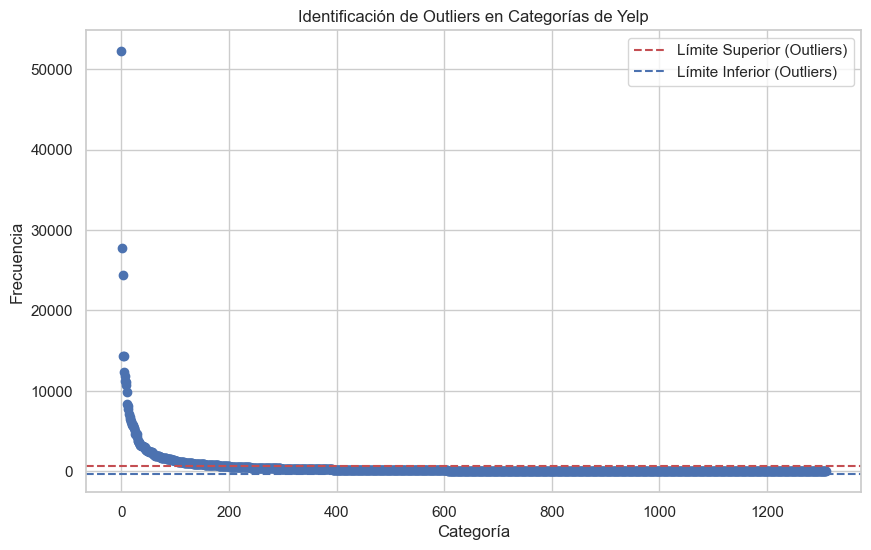

In [53]:
# Gráfico de puntos para identificar outliers
plt.figure(figsize=(10, 6))
plt.scatter(range(len(unicos_categories_yelp)), unicos_categories_yelp)
plt.axhline(y=limite_superior, color='r', linestyle='--', label='Límite Superior (Outliers)')
plt.axhline(y=limite_inferior, color='b', linestyle='--', label='Límite Inferior (Outliers)')
plt.title('Identificación de Outliers en Categorías de Yelp')
plt.xlabel('Categoría')
plt.ylabel('Frecuencia')
plt.legend()
plt.show()

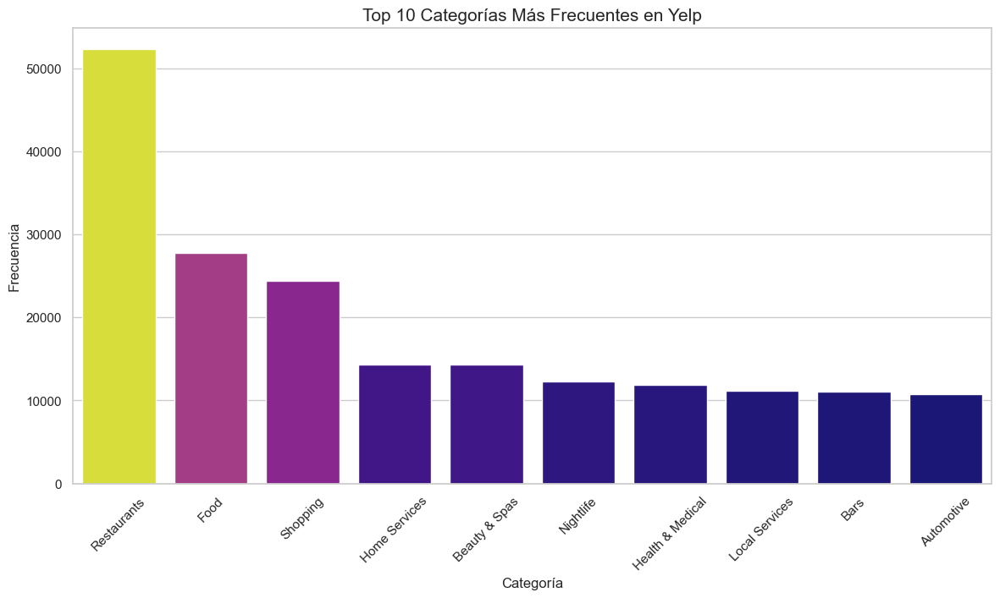

In [55]:
# Configuración de estilo
sns.set(style="whitegrid")

# Gráfico de barras para las categorías más frecuentes
plt.figure(figsize=(14, 7))
sns.barplot(x=unicos_categories_yelp.head(10).index, y=unicos_categories_yelp.head(10).values, palette="plasma", hue=unicos_categories_yelp.head(10), dodge=False, legend=False)
plt.title('Top 10 Categorías Más Frecuentes en Yelp', fontsize=15)
plt.xlabel('Categoría', fontsize=12)
plt.ylabel('Frecuencia', fontsize=12)
plt.xticks(rotation=45)
plt.show()

In [59]:
# Calcular la frecuencia de cada categoría
frecuencia_categorias_yelp = yelp_exploded['categories'].value_counts()

# Calcular los cuartiles y el rango intercuartílico
Q1 = frecuencia_categorias_yelp.quantile(0.25)
Q3 = frecuencia_categorias_yelp.quantile(0.75)
IQR = Q3 - Q1

# Definir los límites de los outliers
limite_superior = Q3 + 1.5 * IQR

# Identificar las categorías que son outliers (por arriba del límite superior)
outliers_sup = frecuencia_categorias_yelp[frecuencia_categorias_yelp > limite_superior]
top_10_outliers_yelp = outliers_sup.head(10)
categorias_outliers_yelp = top_10_outliers_yelp.index

# Obtener los nombres de las empresas y contar el número de empresas por categoría outlier
nombres_categorias_outliers = yelp_exploded[yelp_exploded['categories'].isin(categorias_outliers_yelp)].groupby(['categories'])['name'].apply(lambda x: ', '.join(x.unique())).reset_index()
numero_empresas_por_categoria = yelp_exploded[yelp_exploded['categories'].isin(categorias_outliers_yelp)].groupby(['categories'])['name'].nunique().reset_index(name='number_of_companies')

# Crear un DataFrame final con la información requerida
df_resultado_yelp = pd.DataFrame({
    'categories': top_10_outliers_yelp.index,
    'frequency': top_10_outliers_yelp.values,
}).merge(nombres_categorias_outliers, on='categories').merge(numero_empresas_por_categoria, on='categories')

# Renombrar las columnas para los encabezados especificados
df_resultado_yelp.columns = ['Categoría', 'Frecuencia Categoría', 'Nombre de los negocios', 'Número de negocios']

display(df_resultado_yelp)

,Categoría,Frecuencia Categoría,Nombre de los negocios,Número de negocios
0,Restaurants,52268,"St Honore Pastries, Sonic Drive-In, Tsevi's Pu...",36732
1,Food,27781,"St Honore Pastries, Perkiomen Valley Brewery, ...",18758
2,Shopping,24395,"Target, Famous Footwear, Marshalls, Herb Impor...",16793
3,Home Services,14356,"Jennie Deckert, AM&PM Locksmith, Absolutely Pe...",13008
4,Beauty & Spas,14292,"Diamond Hair Company, Bala Better Health, Holl...",11593
5,Nightlife,12281,"Tsevi's Pub And Grill, Roast Coffeehouse and W...",11035
6,Health & Medical,11890,"Abby Rappoport, LAC, CMQ, Adams Dental, Bala B...",10060
7,Local Services,11198,"The UPS Store, T-Mobile, All In Shipping, Roy'...",8969
8,Bars,11065,"Tsevi's Pub And Grill, Roast Coffeehouse and W...",9870
9,Automotive,10773,"Arizona Truck Outfitters, Nifty Car Rental, Bi...",7894


## e. Identifica top 10 de negocios por cada una de las 10 categorías que se identifican como outliers por su frecuencia
<a id="sección-6-top10-negocios-categorias-yelp"></a>

In [61]:
# Calcular el top 10 de negocios para cada categoría de yelp
resultados_finales_yelp = []
for categoria in categorias_outliers_yelp:
    df_categoria = yelp_exploded[yelp_exploded['categories'] == categoria]
    top_10_negocios = df_categoria['name'].value_counts().head(10)
    total_negocios_categoria = df_categoria['name'].value_counts().sum()
    for negocio, frecuencia in top_10_negocios.items():
        porcentaje = (frecuencia / total_negocios_categoria) * 100
        resultados_finales_yelp.append([categoria, negocio, frecuencia, porcentaje])

# Crear un DataFrame final con el top 10 de negocios para cada categoría, su frecuencia y porcentaje
yelp_top_negocios = pd.DataFrame(resultados_finales_yelp, columns=['Categoría', 'Negocio', 'Frecuencia', 'Porcentaje'])

# Mostrar el DataFrame final
display(yelp_top_negocios)

,Categoría,Negocio,Frecuencia,Porcentaje
0,Restaurants,McDonald's,703,1.344991
1,Restaurants,Subway,459,0.878166
2,Restaurants,Taco Bell,365,0.698324
3,Restaurants,Burger King,338,0.646667
4,Restaurants,Wendy's,331,0.633275
...,...,...,...,...
95,Automotive,Midas,77,0.714750
96,Automotive,Valvoline Instant Oil Change,70,0.649773
97,Automotive,Tires Plus,59,0.547665
98,Automotive,Advance Auto Parts,59,0.547665


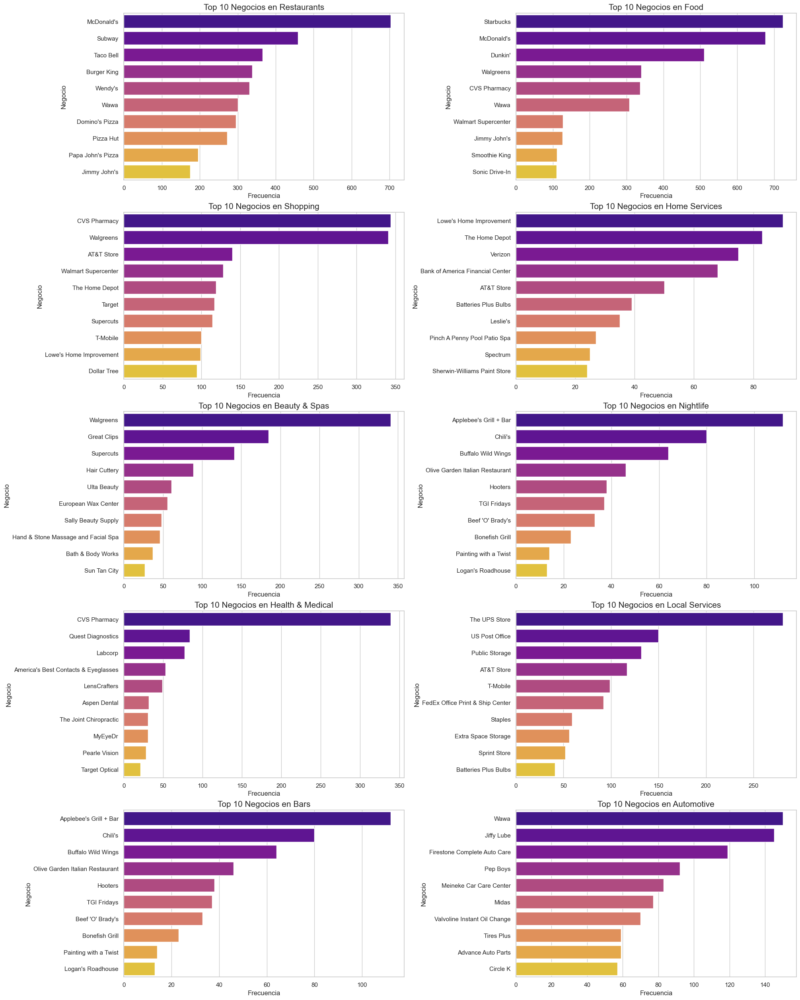

In [64]:
# Crear gráficos para cada categoría
sns.set(style="whitegrid")
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 25), constrained_layout=True)

for i, categoria in enumerate(categorias_outliers_yelp):
    df_categoria = yelp_top_negocios[yelp_top_negocios['Categoría'] == categoria]
    ax = axes[i // 2, i % 2]
    sns.barplot(x='Frecuencia', y='Negocio', hue='Negocio', data=df_categoria, ax=ax, palette="plasma", dodge=False, legend=False)
    ax.set_title(f'Top 10 Negocios en {categoria}', fontsize=15)
    ax.set_xlabel('Frecuencia', fontsize=12)
    ax.set_ylabel('Negocio', fontsize=12)

plt.show()

## f. Mapa de densidad de negocios
<a id="sección-7-densidad_negocios-yelp"></a>

In [66]:
# Filtrar los datos según el DataFrame resultados_finales
top_categories_yelp = yelp_top_negocios['Categoría'].tolist()
yelp_filtered = yelp_exploded[yelp_exploded['categories'].isin(top_categories_yelp)]

# Crear un mapa base con folium
m = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# Agregar datos de densidad al mapa
heat_data = [[row['latitude'], row['longitude']] for index, row in yelp_filtered.iterrows()]
HeatMap(heat_data).add_to(m)

m

In [68]:
# Crear un mapa base con folium
m = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# Agregar datos de densidad al mapa
heat_data = [[row['latitude'], row['longitude']] for index, row in yelp_exploded.iterrows()]
HeatMap(heat_data).add_to(m)
m